In [ ]:
!pip install roboflow
!pip install ultralytics


  Using cached ultralytics-8.2.28-py3-none-any.whl (779 kB)
  Using cached ultralytics_thop-0.2.7-py3-none-any.whl (25 kB)
  Using cached nvidia_cuda_nvrtc_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (23.7 MB)
  Using cached nvidia_cuda_runtime_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (823 kB)
  Using cached nvidia_cuda_cupti_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (14.1 MB)
  Using cached nvidia_cudnn_cu12-8.9.2.26-py3-none-manylinux1_x86_64.whl (731.7 MB)
  Using cached nvidia_cublas_cu12-12.1.3.1-py3-none-manylinux1_x86_64.whl (410.6 MB)
  Using cached nvidia_cufft_cu12-11.0.2.54-py3-none-manylinux1_x86_64.whl (121.6 MB)
  Using cached nvidia_curand_cu12-10.3.2.106-py3-none-manylinux1_x86_64.whl (56.5 MB)
  Using cached nvidia_cusolver_cu12-11.4.5.107-py3-none-manylinux1_x86_64.whl (124.2 MB)
  Using cached nvidia_cusparse_cu12-12.1.0.106-py3-none-manylinux1_x86_64.whl (196.0 MB)
  Using cached nvidia_nccl_cu12-2.20.5-py3-none-manylinux2014_x86_64.whl (176.2 MB)
  Using ca

In [ ]:
from google.colab import drive
drive.mount('/content/drive')


Mounted at /content/drive


In [ ]:
from roboflow import Roboflow
rf = Roboflow(api_key="ytSgWGrTI7usY18FOAg2")
project = rf.workspace("toby-ai").project("cigarette-83q14")
version = project.version(4)
dataset = version.download("yolov8")


loading Roboflow workspace...
loading Roboflow project...
Dependency ultralytics==8.0.196 is required but found version=8.2.28, to fix: `pip install ultralytics==8.0.196`



Extracting Dataset Version Zip to cigarette-4 in yolov8:: 100%|██████████| 250/250 [00:00<00:00, 4224.30it/s]


In [ ]:
import os

base_dir = '/content/cigarette-4'
train_images_dir = os.path.join(base_dir, 'train', 'images')
train_labels_dir = os.path.join(base_dir, 'train', 'labels')
data_yaml_path = os.path.join(base_dir, 'data.yaml')

print(f'Train images directory: {train_images_dir}')
print(f'Train labels directory: {train_labels_dir}')
print(f'Data YAML path: {data_yaml_path}')


Train images directory: /content/cigarette-4/train/images
Train labels directory: /content/cigarette-4/train/labels
Data YAML path: /content/cigarette-4/data.yaml


In [ ]:
data_yaml_content = """
train: /content/cigarette-4/train/images
val: /content/cigarette-4/train/images

nc: 1
names: ['cig_butt']
"""

data_yaml_path = '/content/cigarette-4/data.yaml'

with open(data_yaml_path, 'w') as file:
    file.write(data_yaml_content)


In [ ]:
data_yaml_path = '/content/cigarette-4/data.yaml'

with open(data_yaml_path, 'r') as file:
    data_yaml_content = file.read()

print(data_yaml_content)



train: /content/cigarette-4/train/images
val: /content/cigarette-4/train/images

nc: 1
names: ['cig_butt']



In [ ]:
from ultralytics import YOLO

# Учитај YOLOv8 модел (замени 'yolov8n.pt' са моделом који желиш да користиш)
model = YOLO('yolov8n.pt')

# Обучавање модела
model.train(data=data_yaml_path, epochs=10, imgsz=640)


Ultralytics YOLOv8.2.28 🚀 Python-3.10.12 torch-2.3.0+cu121 CPU (Intel Xeon 2.20GHz)
engine/trainer: task=detect, mode=train, model=yolov8n.pt, data=/content/cigarette-4/data.yaml, epochs=10, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train4, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True, sho

train: Scanning /content/cigarette-4/train/labels.cache... 122 images, 0 backgrounds, 0 corrupt: 100%|██████████| 122/122 [00:00<?, ?it/s]

albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))



val: Scanning /content/cigarette-4/train/labels.cache... 122 images, 0 backgrounds, 0 corrupt: 100%|██████████| 122/122 [00:00<?, ?it/s]

Plotting labels to runs/detect/train4/labels.jpg... 


optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.002, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 0 dataloader workers
Logging results to runs/detect/train4
Starting training for 10 epochs...
Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/10         0G      1.669      3.654      1.585         13        640: 100%|██████████| 8/8 [01:50<00:00, 13.81s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:28<00:00,  7.16s/it]

                   all        122        146    0.00396      0.993      0.723      0.383



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/10         0G      1.423      2.529      1.428         11        640: 100%|██████████| 8/8 [01:44<00:00, 13.07s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:31<00:00,  7.94s/it]

                   all        122        146    0.00396      0.993      0.864      0.481



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/10         0G      1.359      2.301      1.398         14        640: 100%|██████████| 8/8 [01:48<00:00, 13.55s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:29<00:00,  7.48s/it]

                   all        122        146    0.00396      0.993      0.843      0.503



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/10         0G      1.345      2.098      1.292         12        640: 100%|██████████| 8/8 [01:46<00:00, 13.29s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:29<00:00,  7.30s/it]

                   all        122        146      0.989      0.616      0.898      0.539



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/10         0G      1.268      1.993      1.219         10        640: 100%|██████████| 8/8 [01:46<00:00, 13.33s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:28<00:00,  7.17s/it]

                   all        122        146          1      0.144      0.913       0.56



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/10         0G      1.274       1.88      1.181         11        640: 100%|██████████| 8/8 [01:44<00:00, 13.06s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:29<00:00,  7.29s/it]

                   all        122        146      0.978      0.299      0.838       0.46



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/10         0G      1.296      1.939      1.254         11        640: 100%|██████████| 8/8 [01:46<00:00, 13.33s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:29<00:00,  7.25s/it]

                   all        122        146      0.935      0.591      0.806      0.487



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/10         0G       1.26       1.71      1.224         12        640: 100%|██████████| 8/8 [01:45<00:00, 13.18s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:28<00:00,  7.10s/it]

                   all        122        146      0.991      0.717      0.935       0.58



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/10         0G      1.192      1.723      1.204         10        640: 100%|██████████| 8/8 [01:45<00:00, 13.23s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:29<00:00,  7.39s/it]

                   all        122        146      0.938      0.767      0.947       0.63



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/10         0G      1.183      1.592      1.208         13        640: 100%|██████████| 8/8 [01:46<00:00, 13.27s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:29<00:00,  7.27s/it]

                   all        122        146      0.957      0.766       0.96      0.649



10 epochs completed in 0.382 hours.
Optimizer stripped from runs/detect/train4/weights/last.pt, 6.2MB
Optimizer stripped from runs/detect/train4/weights/best.pt, 6.2MB

Validating runs/detect/train4/weights/best.pt...
Ultralytics YOLOv8.2.28 🚀 Python-3.10.12 torch-2.3.0+cu121 CPU (Intel Xeon 2.20GHz)
Model summary (fused): 168 layers, 3005843 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:28<00:00,  7.10s/it]


                   all        122        146      0.957      0.766       0.96       0.65
Speed: 3.9ms preprocess, 200.7ms inference, 0.0ms loss, 4.8ms postprocess per image
Results saved to runs/detect/train4


ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x7a04c44a70a0>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
          0.048048, 

In [ ]:
import os

base_drive_dir = '/content/drive/MyDrive/some_folder/cig_butts'

for root, dirs, files in os.walk(base_drive_dir):
    level = root.replace(base_drive_dir, '').count(os.sep)
    indent = ' ' * 4 * (level)
    print(f'{indent}{os.path.basename(root)}/')
    subindent = ' ' * 4 * (level + 1)
    for f in files:
        print(f'{subindent}{f}')


Streaming output truncated to the last 5000 lines.
            00001004.jpg
            00001003.jpg
            00001005.jpg
            00001007.jpg
            00001006.jpg
            00001009.jpg
            00001008.jpg
            00001011.jpg
            00001012.jpg
            00001010.jpg
            00001014.jpg
            00001013.jpg
            00001016.jpg
            00001015.jpg
            00001018.jpg
            00001019.jpg
            00001017.jpg
            00001020.jpg
            00001021.jpg
            00001022.jpg
            00001023.jpg
            00001026.jpg
            00001025.jpg
            00001024.jpg
            00001027.jpg
            00001028.jpg
            00001030.jpg
            00001029.jpg
            00001032.jpg
            00001031.jpg
            00001033.jpg
            00001034.jpg
            00001035.jpg
            00001037.jpg
            00001036.jpg
            00001038.jpg
            00001039.jpg
            00001040.jpg

In [ ]:
import cv2
import os

unlabeled_images_dir = '/content/drive/MyDrive/some_folder/cig_butts/train/labeled_images'
output_labels_dir = '/content/drive/MyDrive/some_folder/cig_butts/generated_labels'

if not os.path.exists(output_labels_dir):
    os.makedirs(output_labels_dir)

# FJA ZA GENERISANJE LABELA
def generate_labels(model, image_path, output_label_path):
    results = model(image_path)
    with open(output_label_path, 'w') as file:
        for result in results[0].boxes:
            x1, y1, x2, y2 = result.xyxy[0].int().tolist()
            file.write(f'0 {x1} {y1} {x2} {y2}\n')

for filename in os.listdir(unlabeled_images_dir):
    if filename.endswith('.jpg') or filename.endswith('.png'):
        image_path = os.path.join(unlabeled_images_dir, filename)
        output_label_path = os.path.join(output_labels_dir, filename.replace('.jpg', '.txt').replace('.png', '.txt'))
        generate_labels(model, image_path, output_label_path)
        print(f'Generated label for {filename}')


Streaming output truncated to the last 5000 lines.

image 1/1 /content/drive/MyDrive/some_folder/cig_butts/train/labeled_images/00000750.jpg: 480x640 (no detections), 284.8ms
Speed: 2.7ms preprocess, 284.8ms inference, 0.9ms postprocess per image at shape (1, 3, 480, 640)
Generated label for 00000750.jpg

image 1/1 /content/drive/MyDrive/some_folder/cig_butts/train/labeled_images/00000749.jpg: 480x640 (no detections), 263.8ms
Speed: 3.1ms preprocess, 263.8ms inference, 0.9ms postprocess per image at shape (1, 3, 480, 640)
Generated label for 00000749.jpg

image 1/1 /content/drive/MyDrive/some_folder/cig_butts/train/labeled_images/00000753.jpg: 480x640 (no detections), 292.3ms
Speed: 2.6ms preprocess, 292.3ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)
Generated label for 00000753.jpg

image 1/1 /content/drive/MyDrive/some_folder/cig_butts/train/labeled_images/00000752.jpg: 480x640 (no detections), 298.5ms
Speed: 2.7ms preprocess, 298.5ms inference, 0.9ms postproces

Visualizing 00000001.jpg


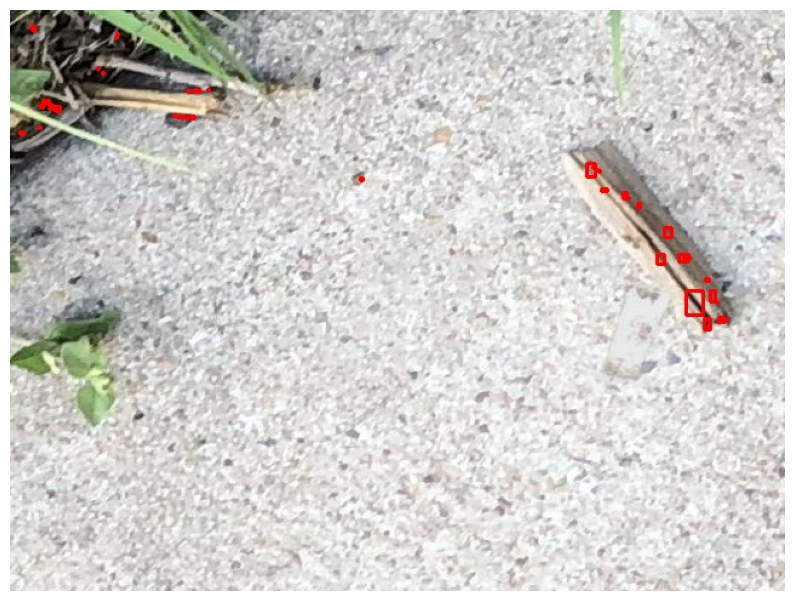

Visualizing 00000000.jpg


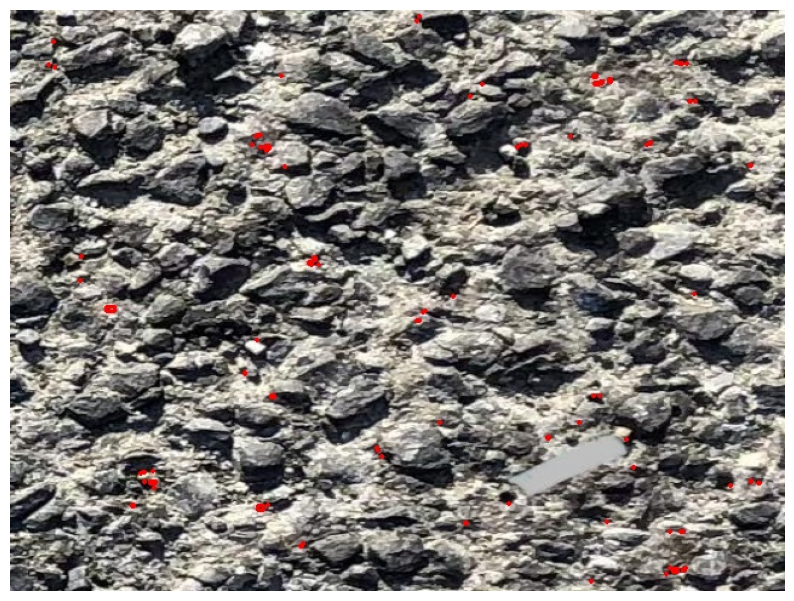

Visualizing 00000002.jpg


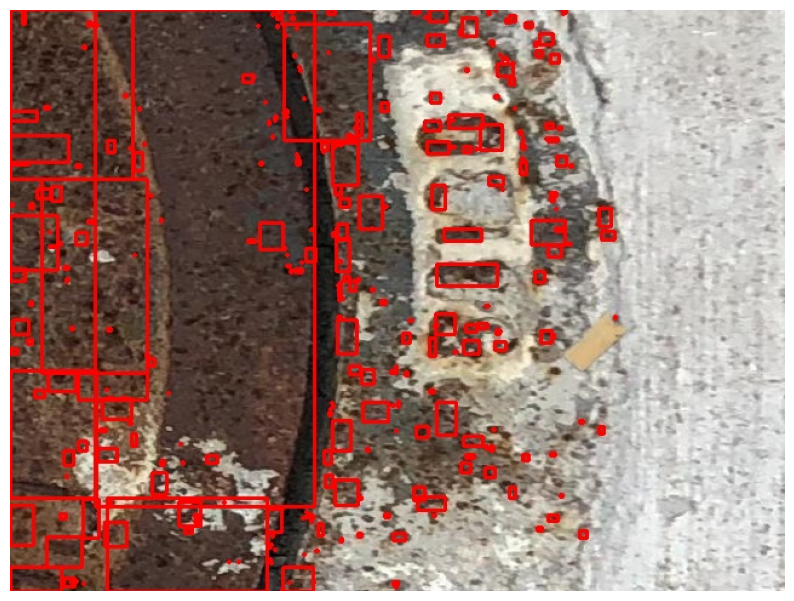

Visualizing 00000004.jpg


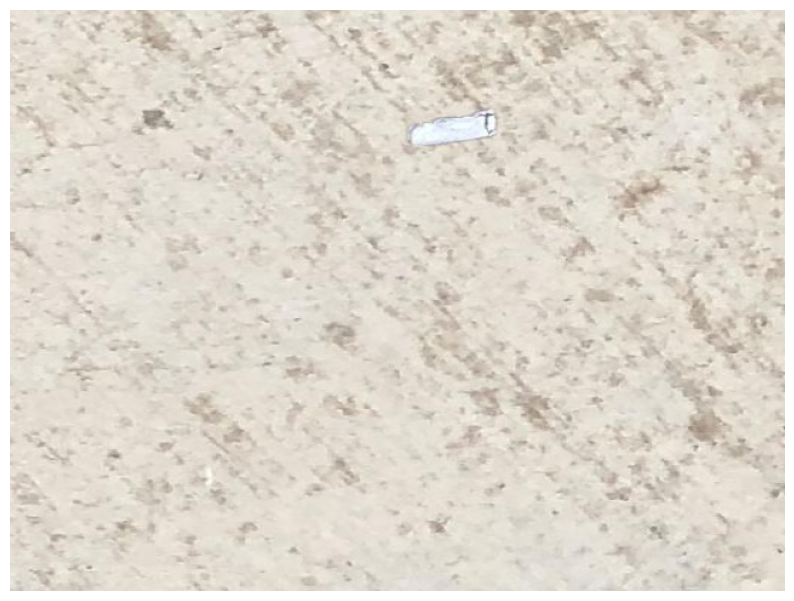

Visualizing 00000003.jpg


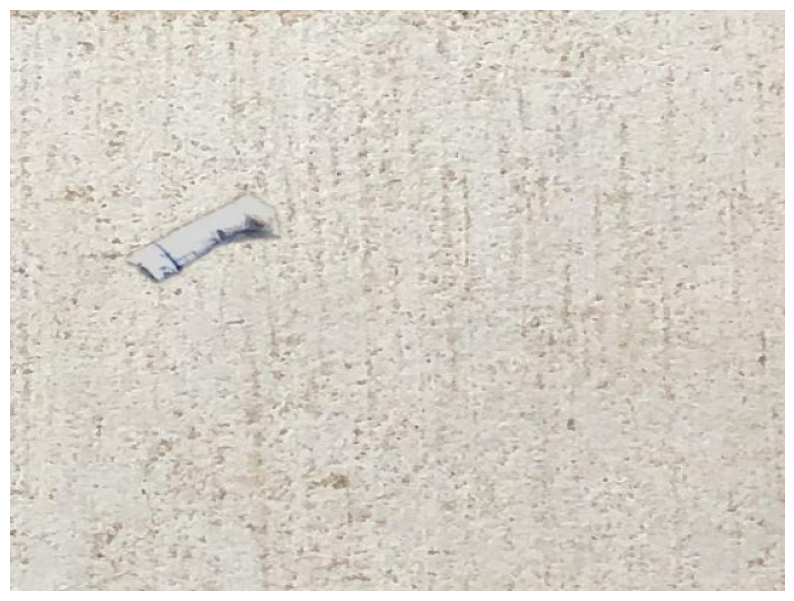

Visualizing 00000006.jpg


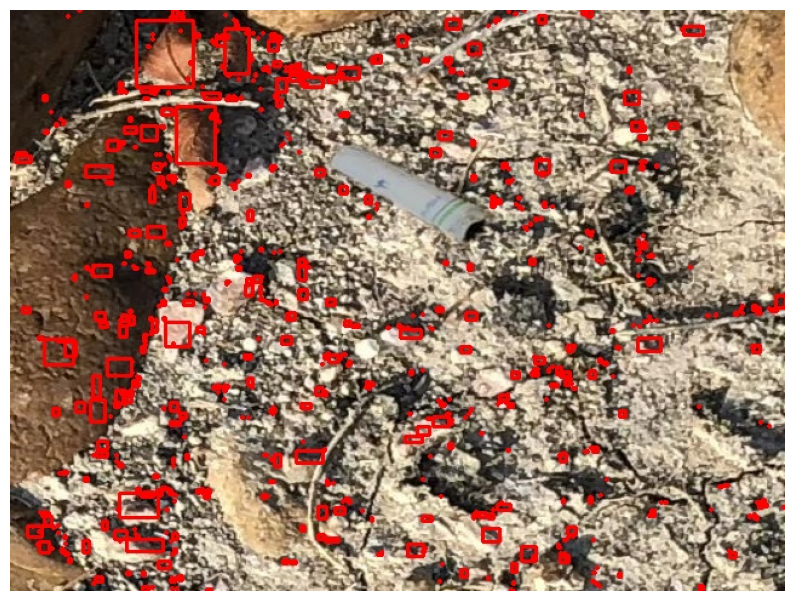

Visualizing 00000005.jpg


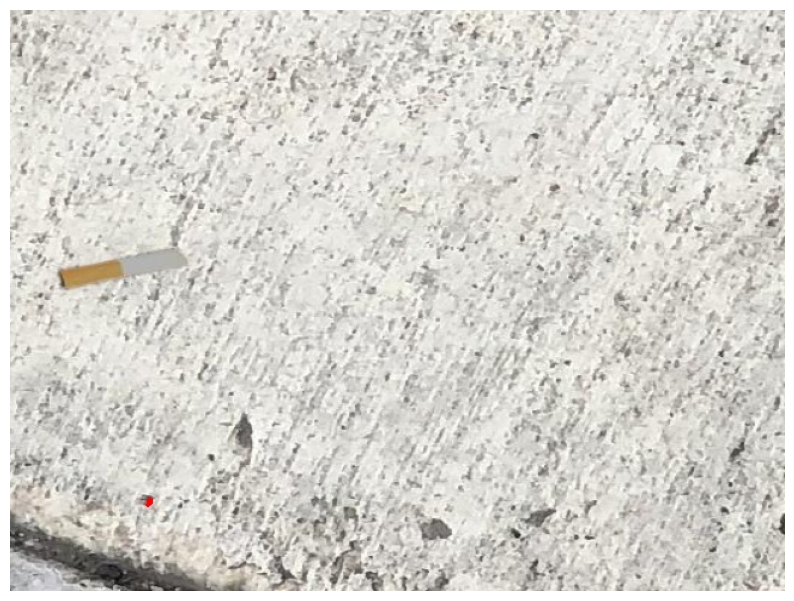

Visualizing 00000007.jpg


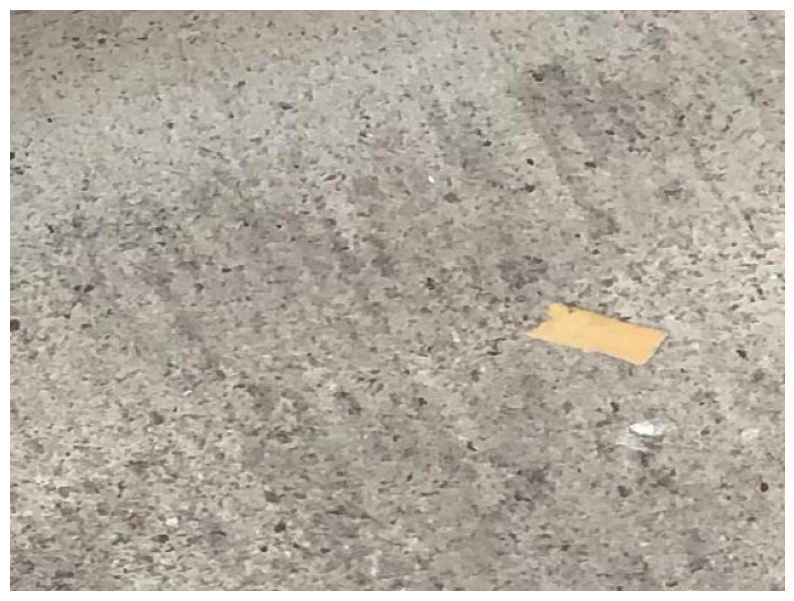

Visualizing 00000008.jpg


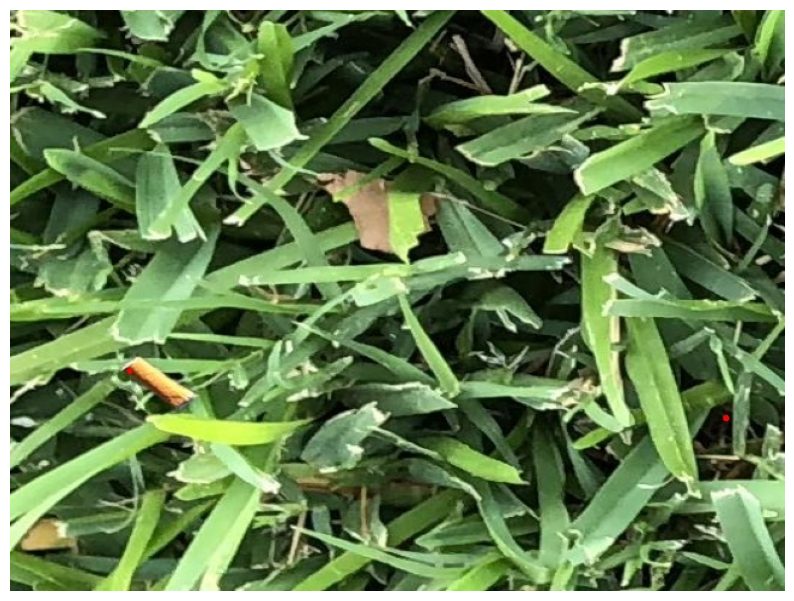

Visualizing 00000011.jpg


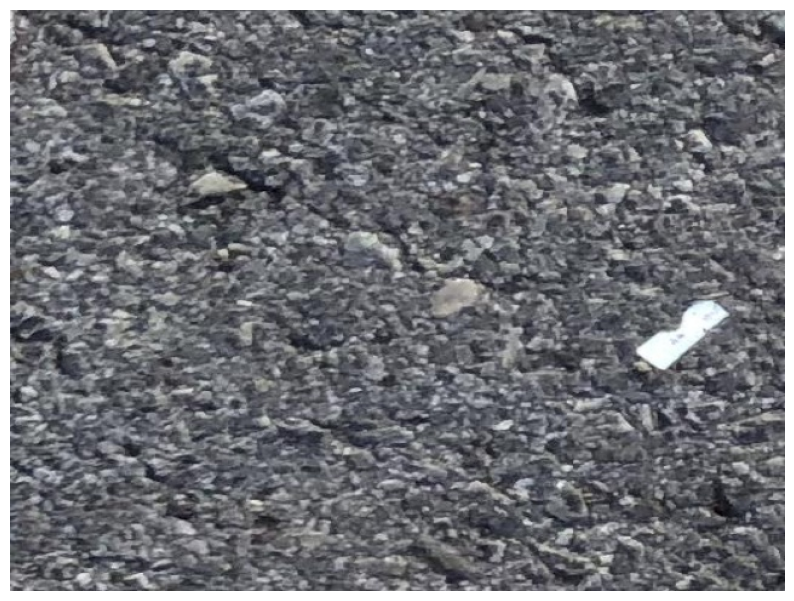

Visualizing 00000009.jpg


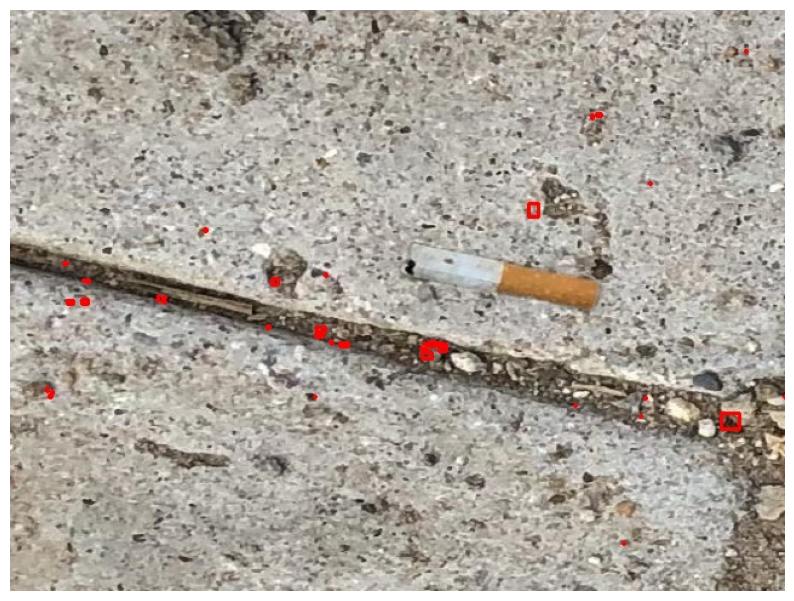

Visualizing 00000010.jpg


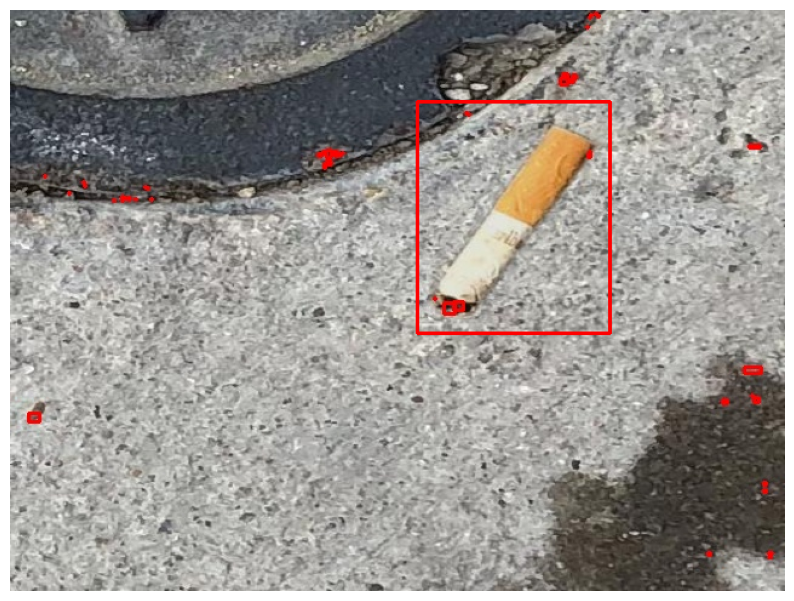

Visualizing 00000012.jpg


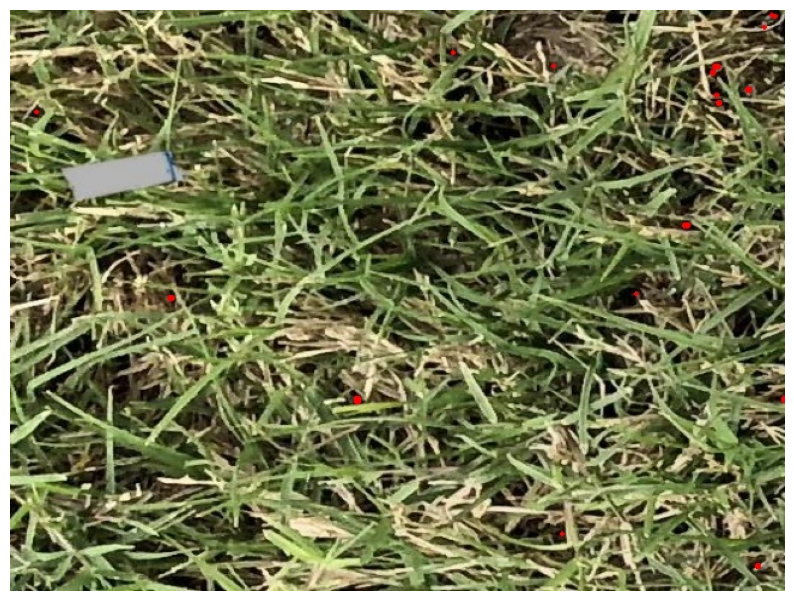

Visualizing 00000013.jpg


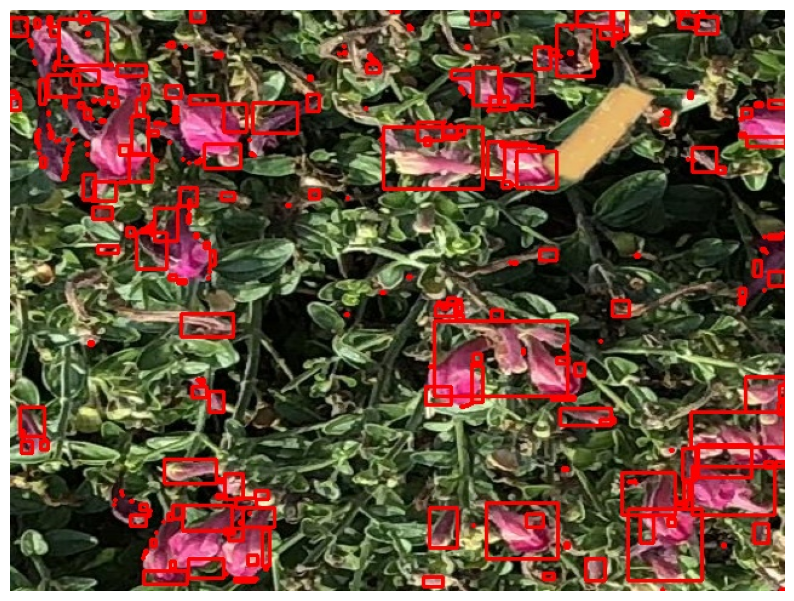

Visualizing 00000014.jpg


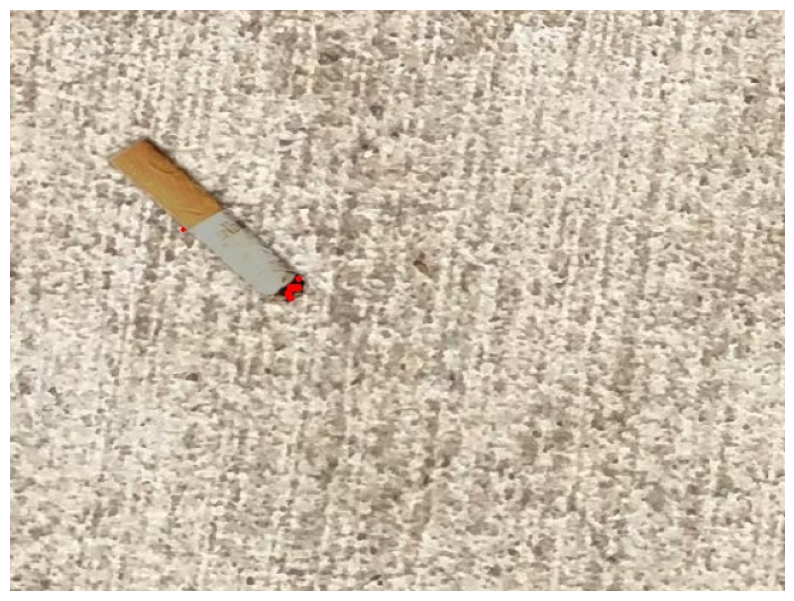

Visualizing 00000015.jpg


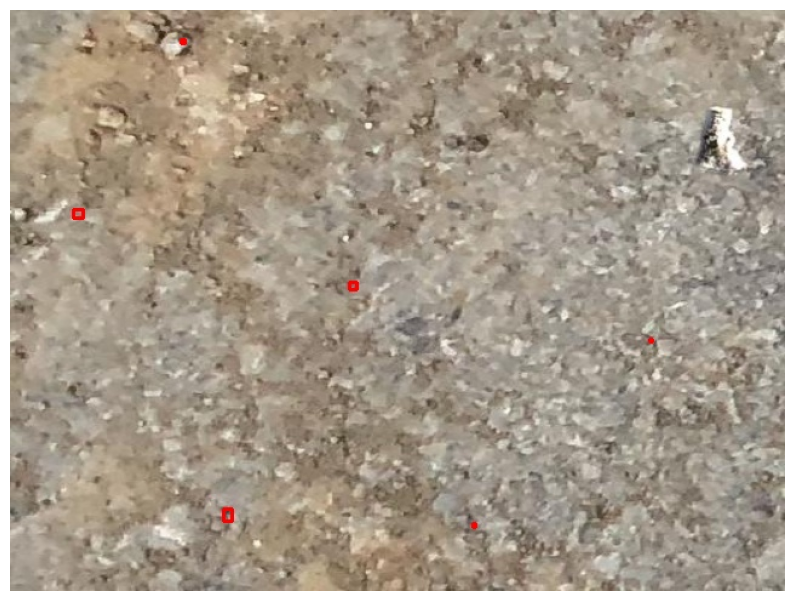

Visualizing 00000016.jpg


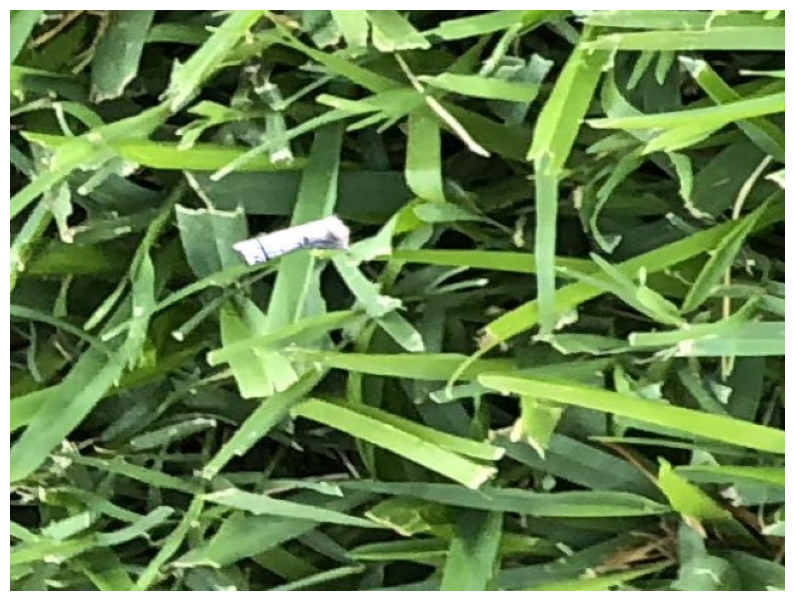

Visualizing 00000018.jpg


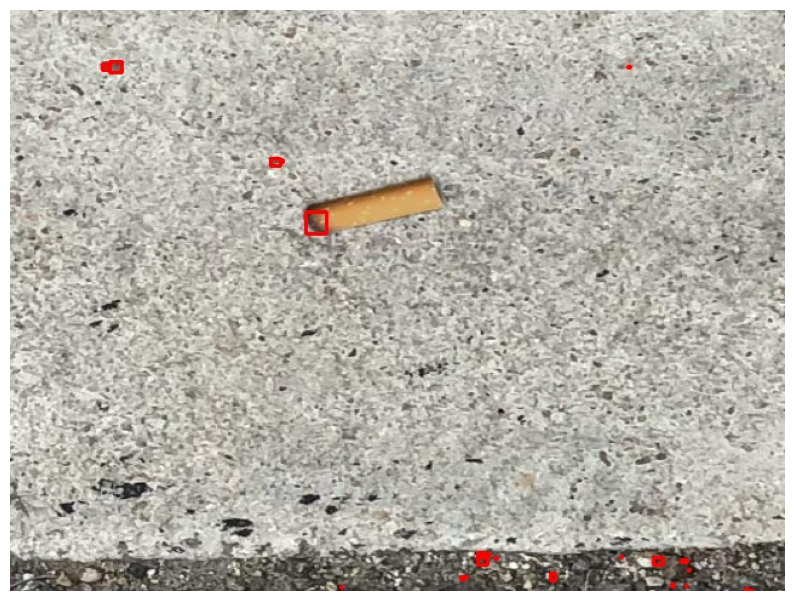

Visualizing 00000017.jpg


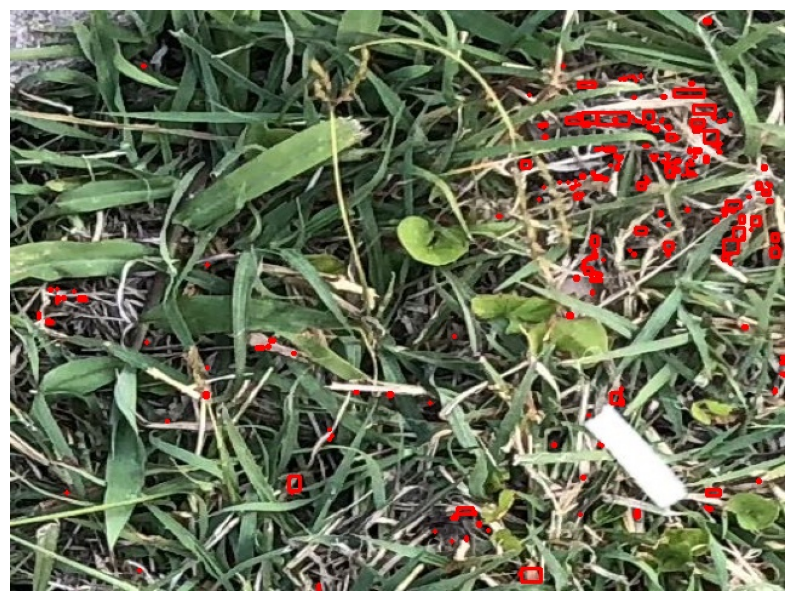

Visualizing 00000020.jpg


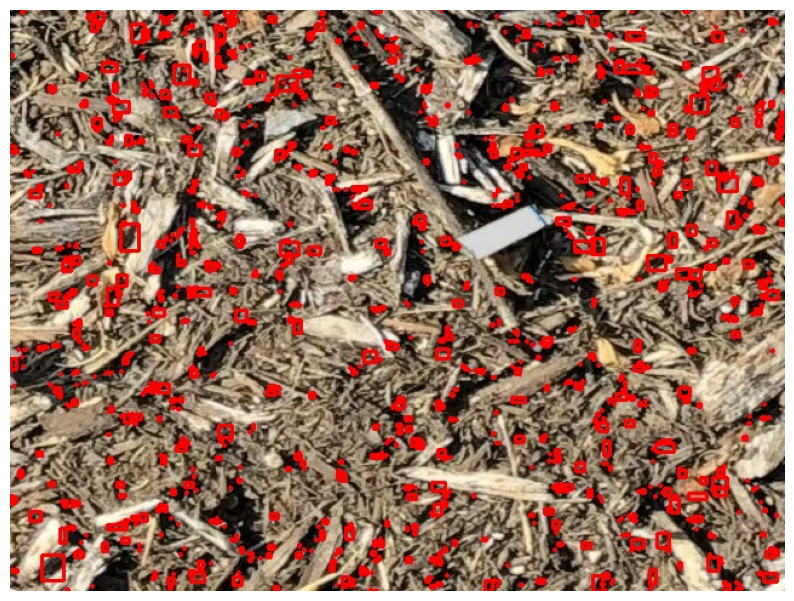

Visualizing 00000019.jpg


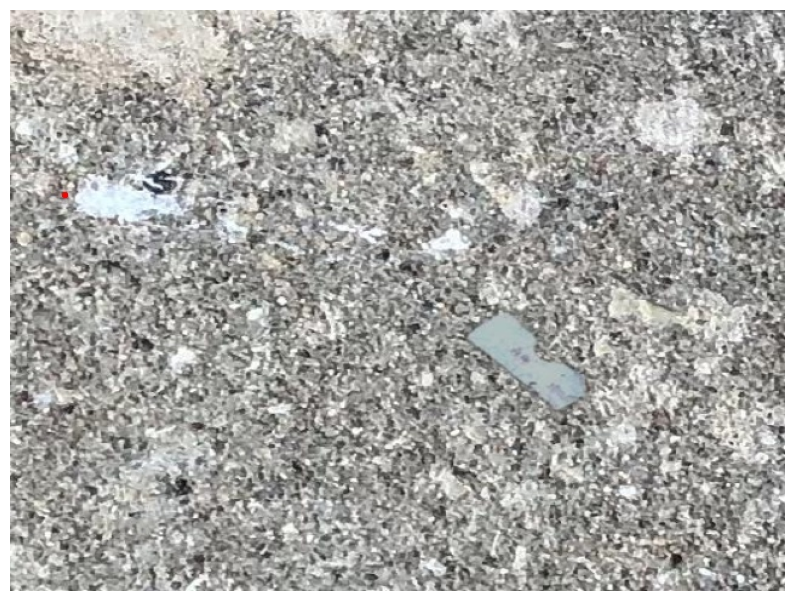

Visualizing 00000022.jpg


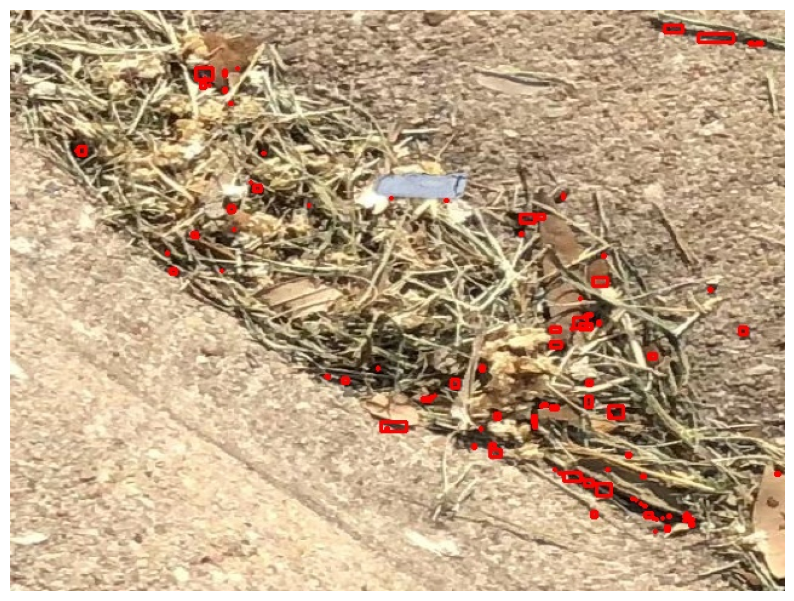

Visualizing 00000021.jpg


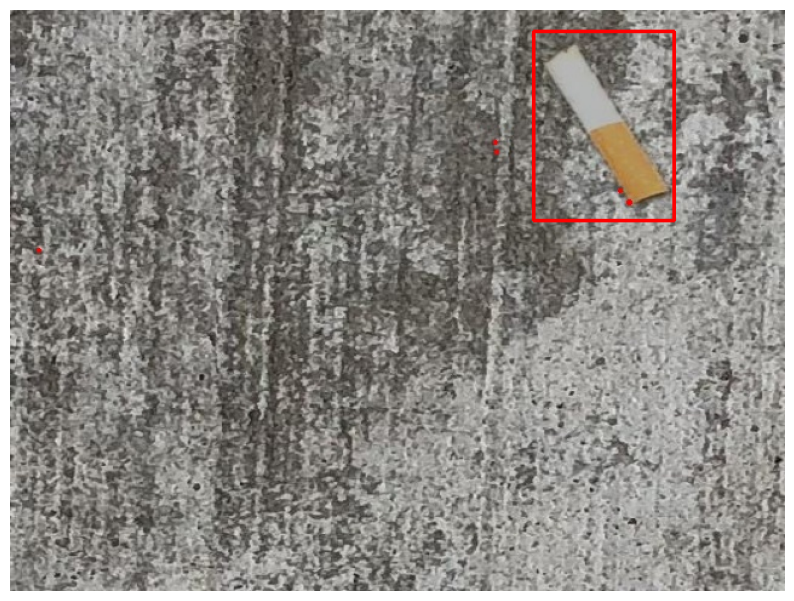

Visualizing 00000024.jpg


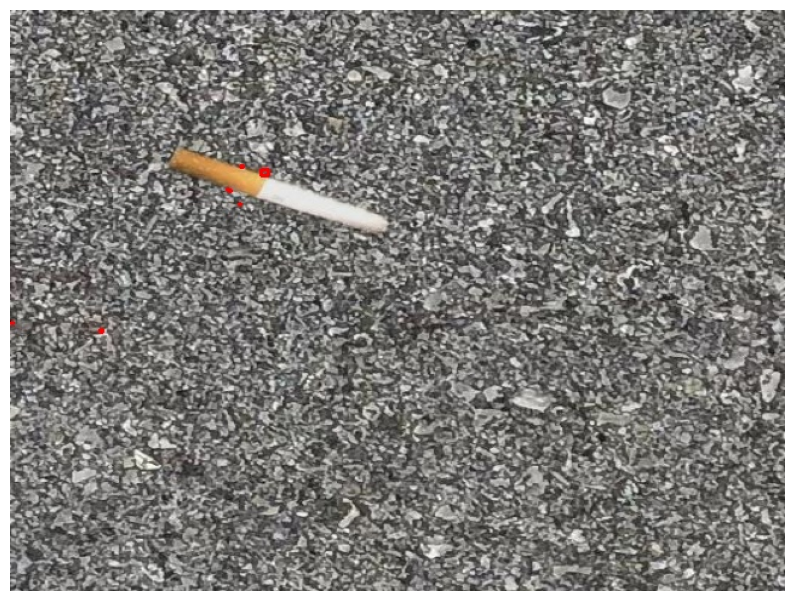

Visualizing 00000023.jpg


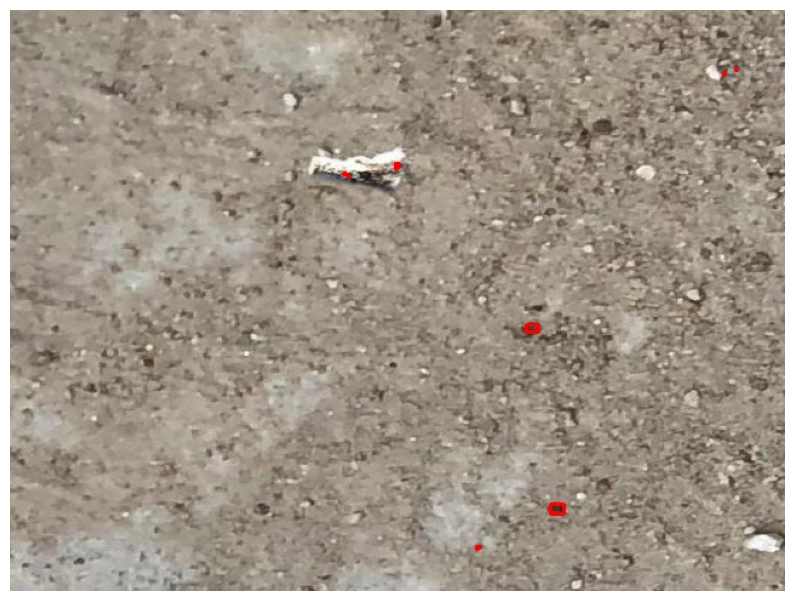

Visualizing 00000026.jpg


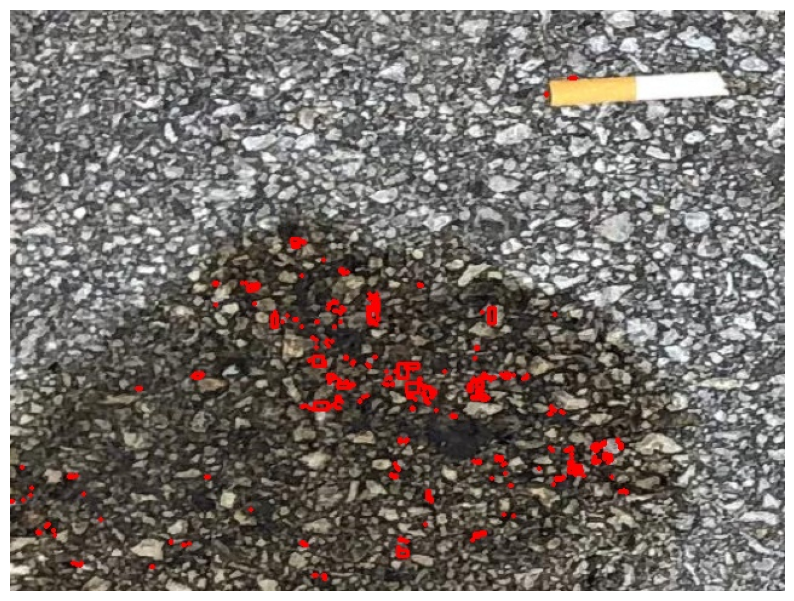

Visualizing 00000025.jpg


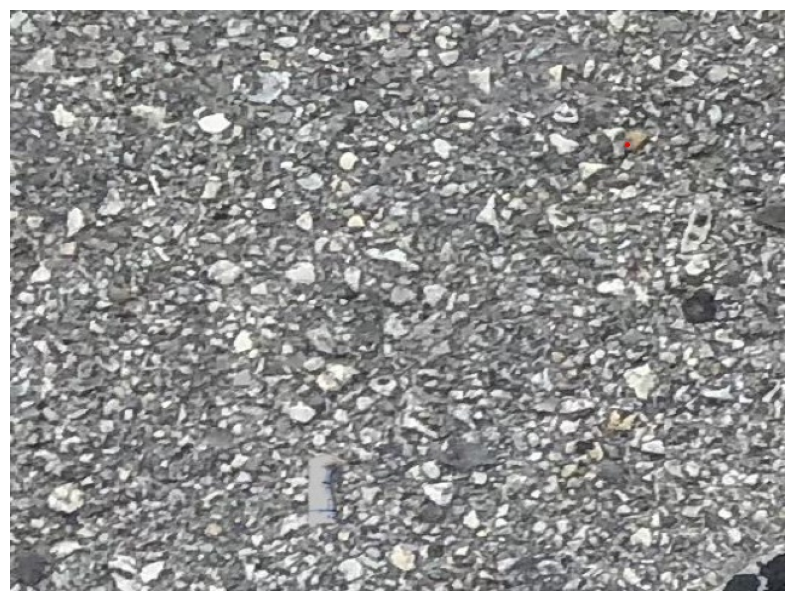

Visualizing 00000027.jpg


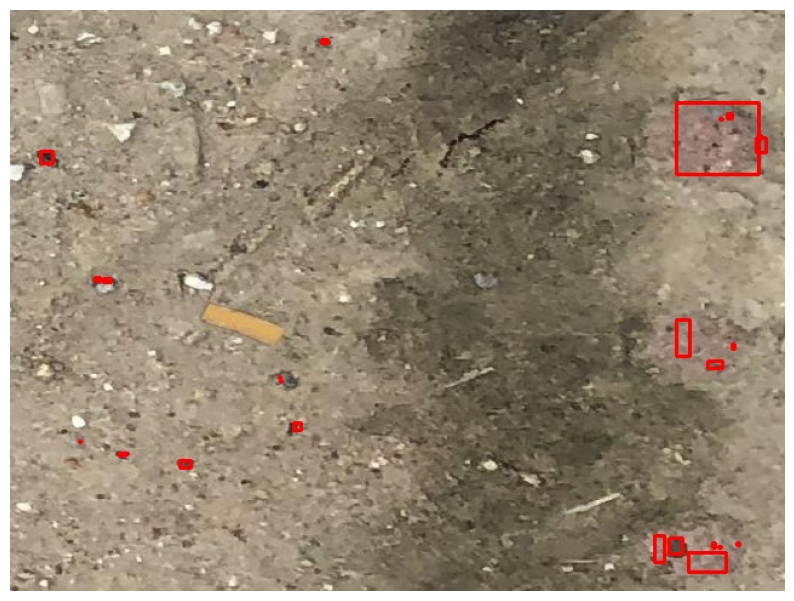

Visualizing 00000028.jpg


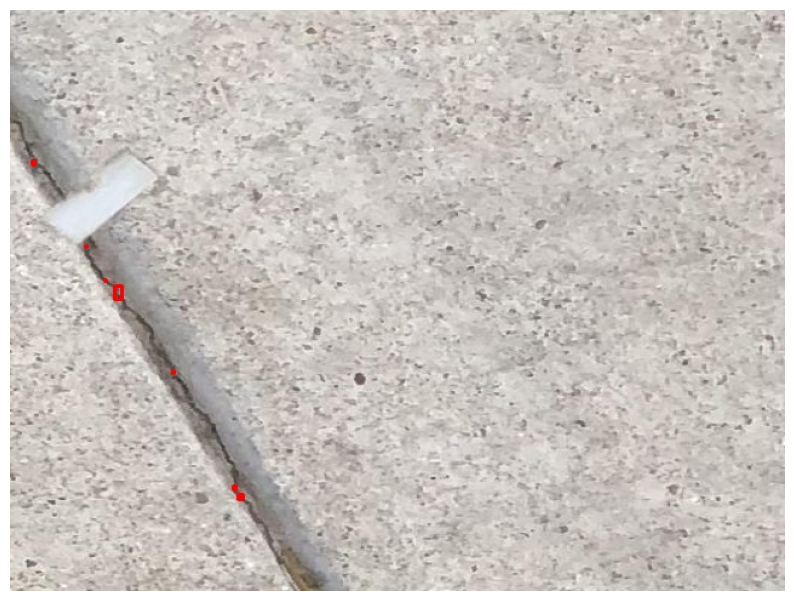

Visualizing 00000029.jpg


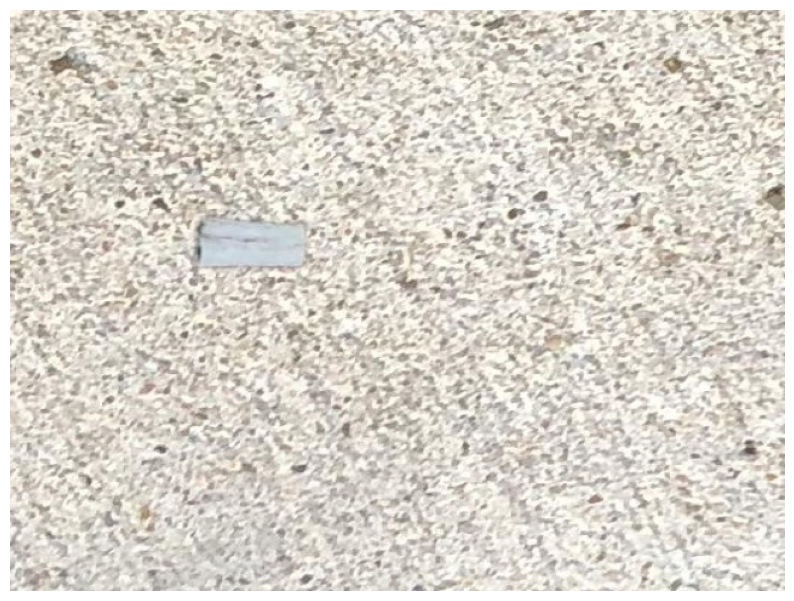

Visualizing 00000030.jpg


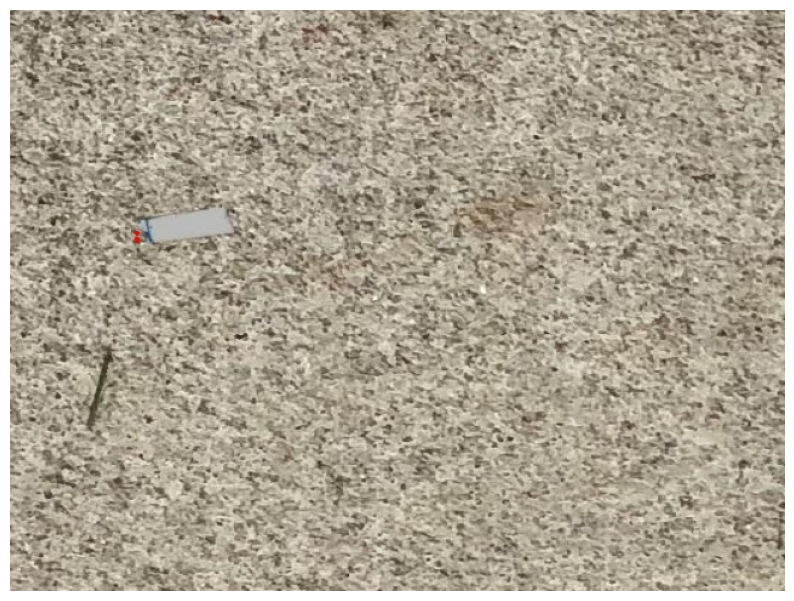

Visualizing 00000031.jpg


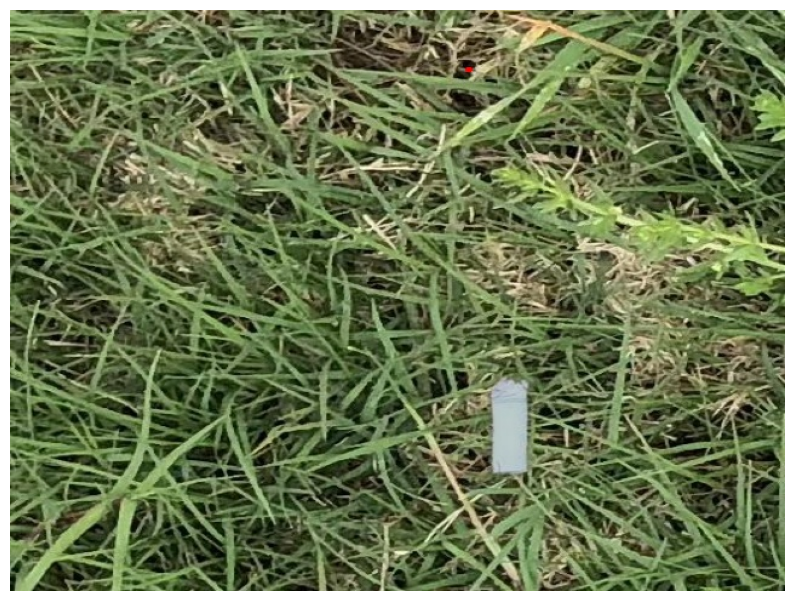

Visualizing 00000032.jpg


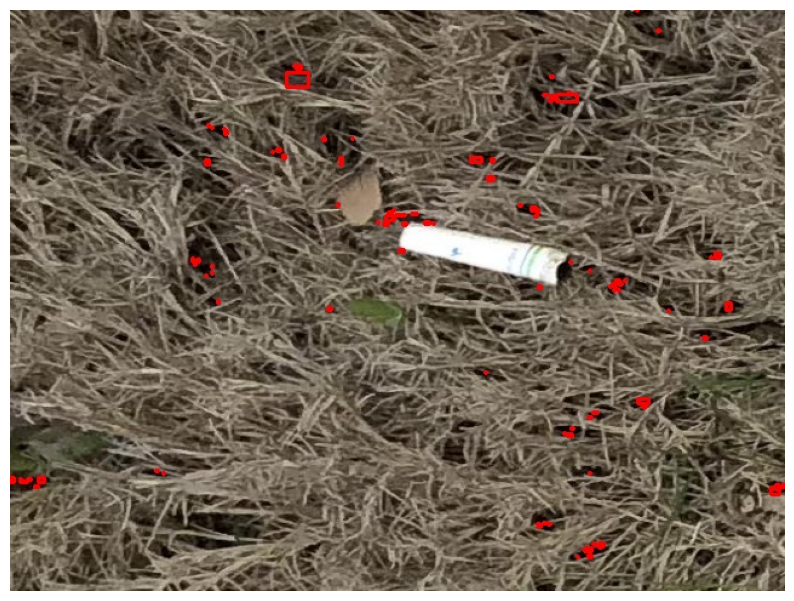

Visualizing 00000033.jpg


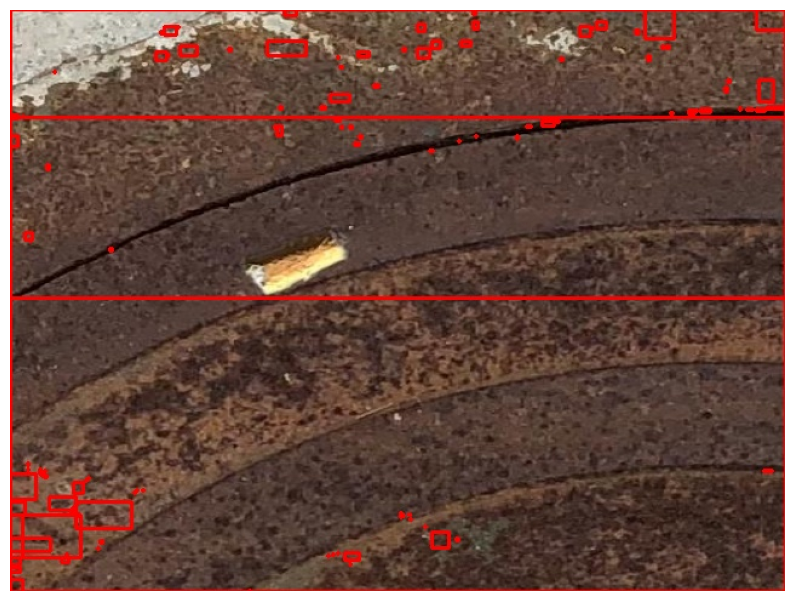

Visualizing 00000034.jpg


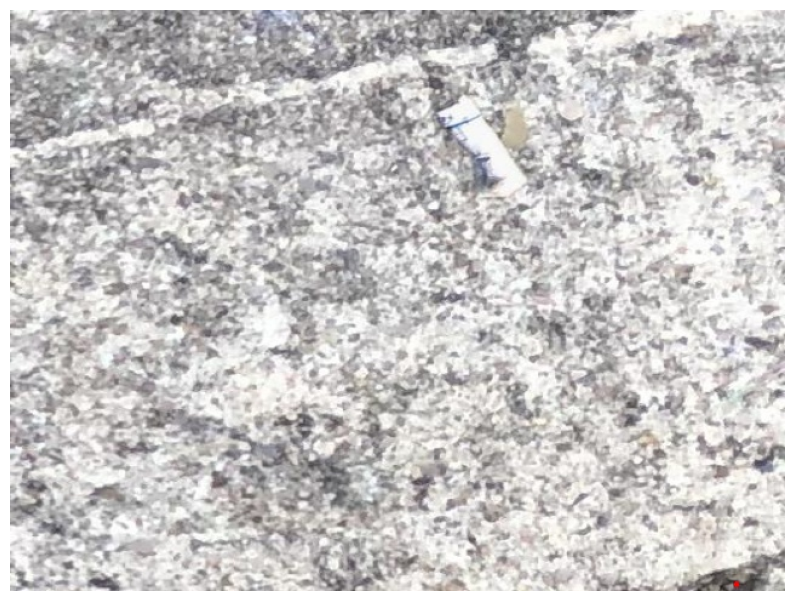

Visualizing 00000035.jpg


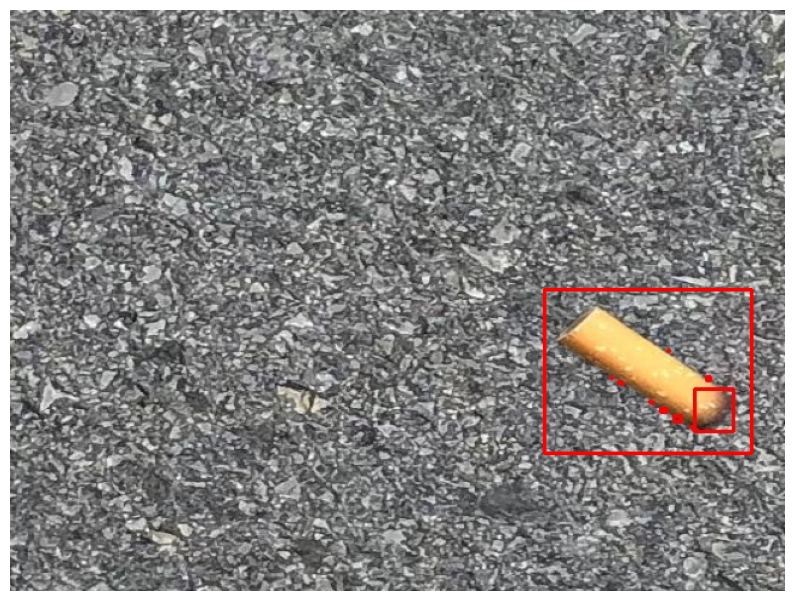

Visualizing 00000036.jpg


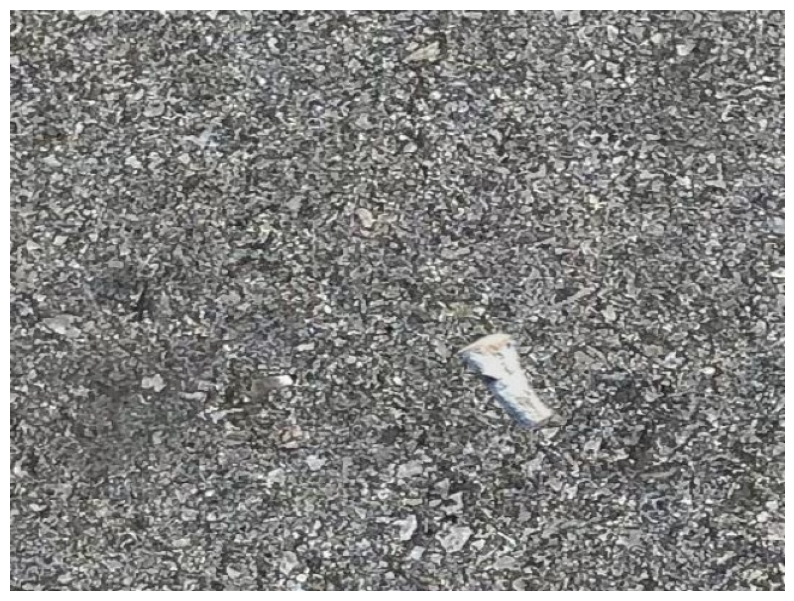

Visualizing 00000038.jpg


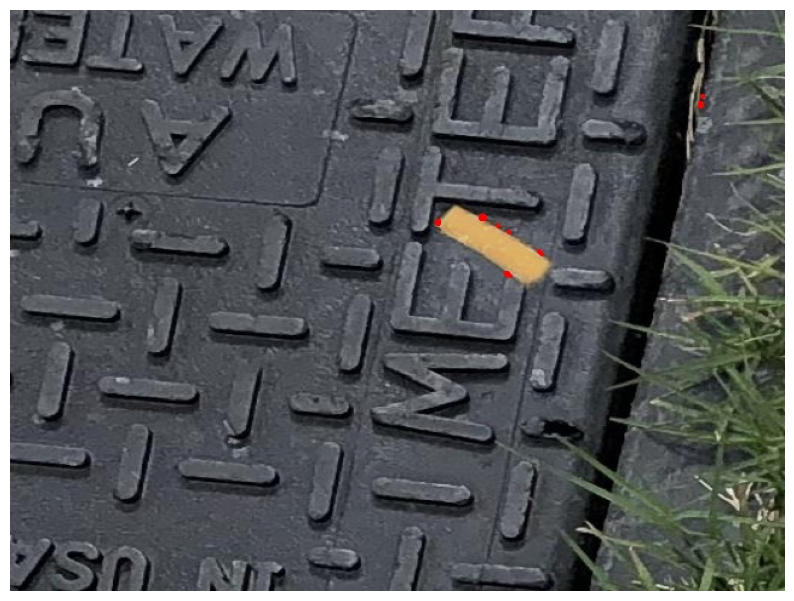

Visualizing 00000037.jpg


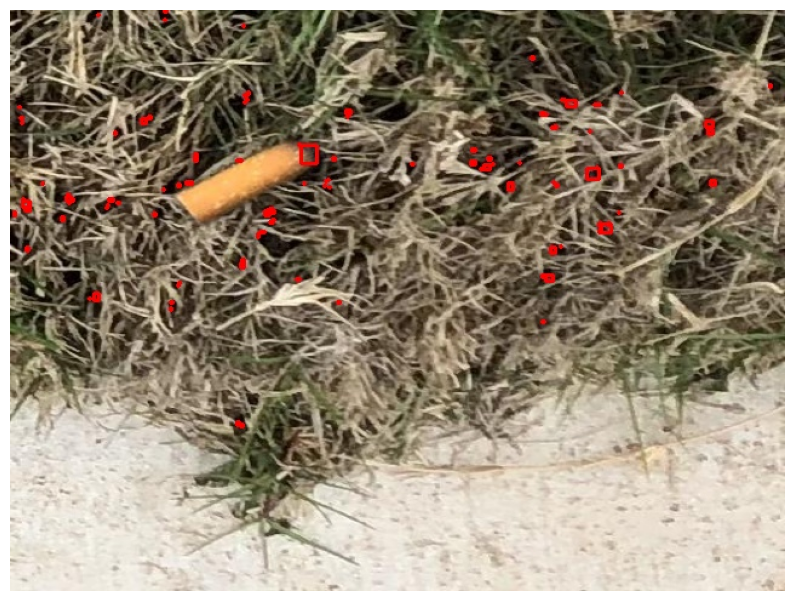

Visualizing 00000039.jpg


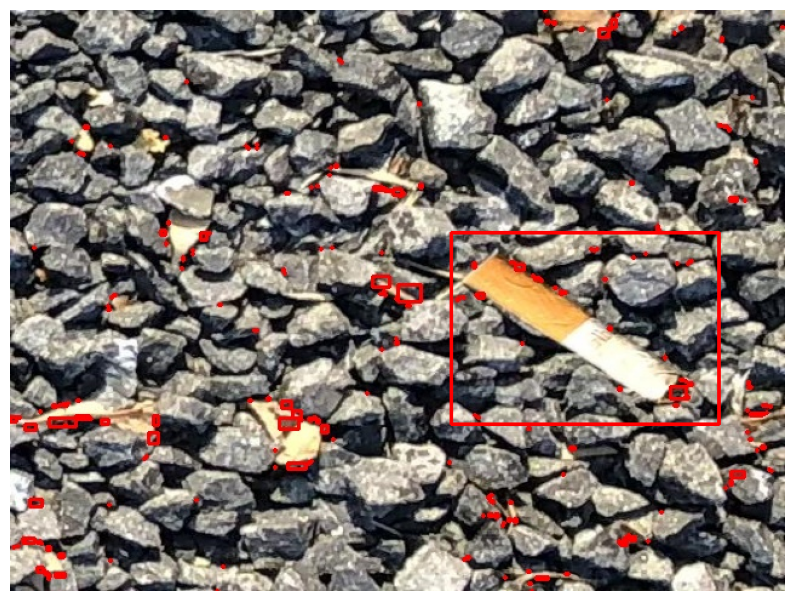

Visualizing 00000041.jpg


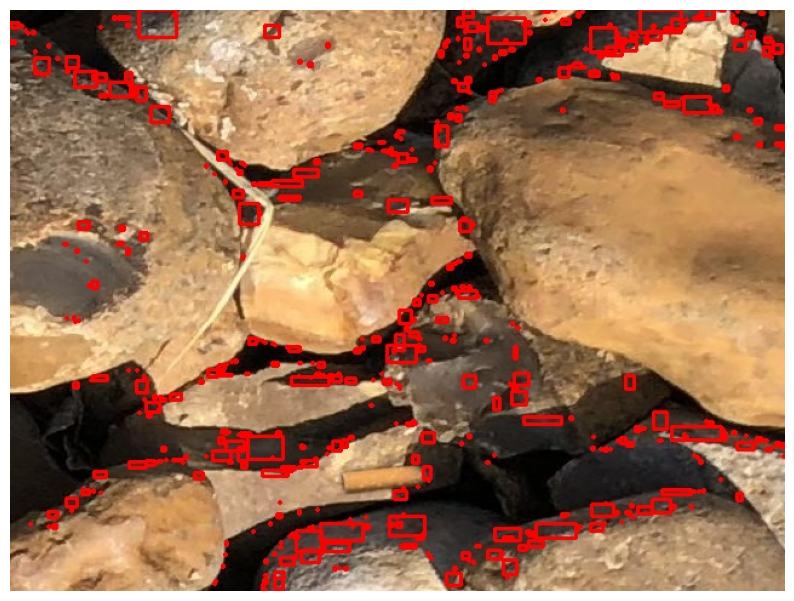

Visualizing 00000040.jpg


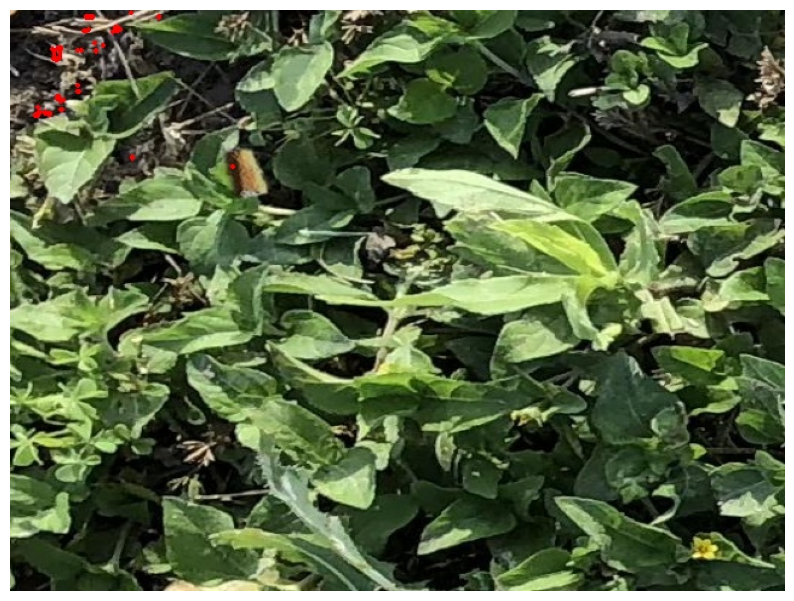

Visualizing 00000043.jpg


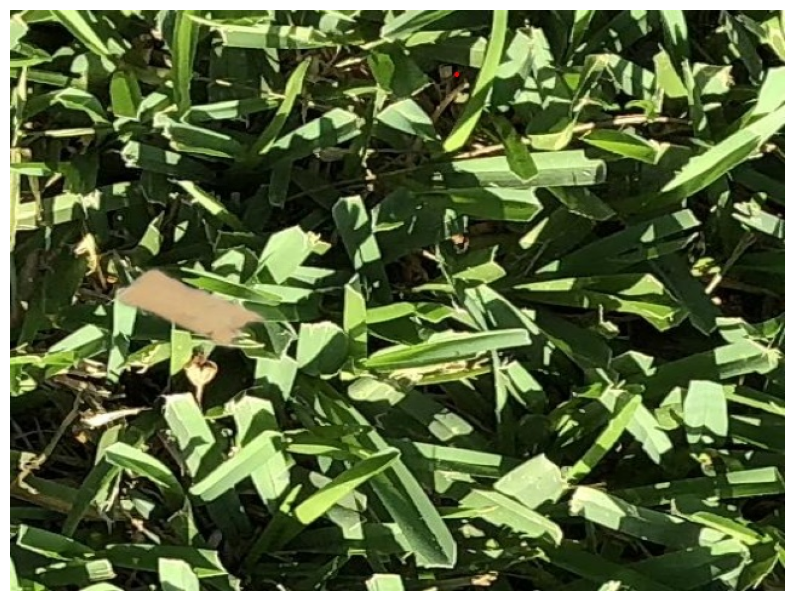

Visualizing 00000042.jpg


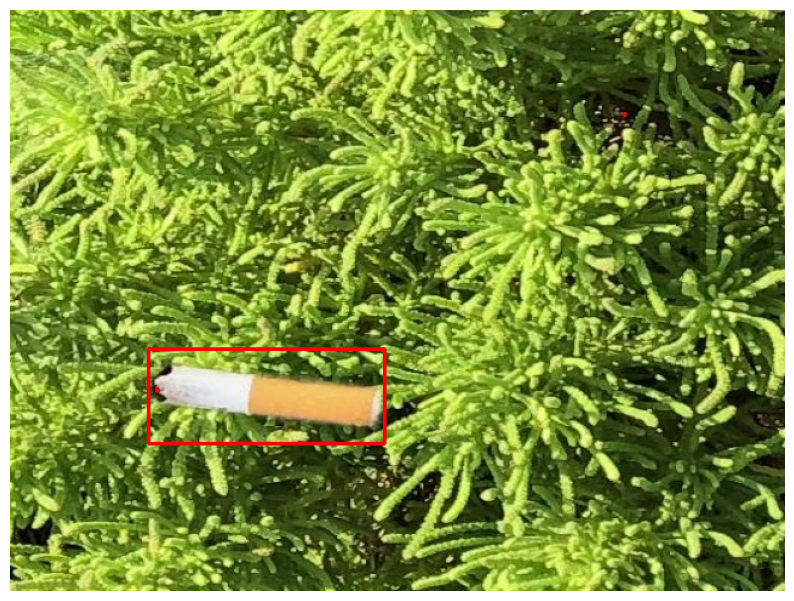

Visualizing 00000044.jpg


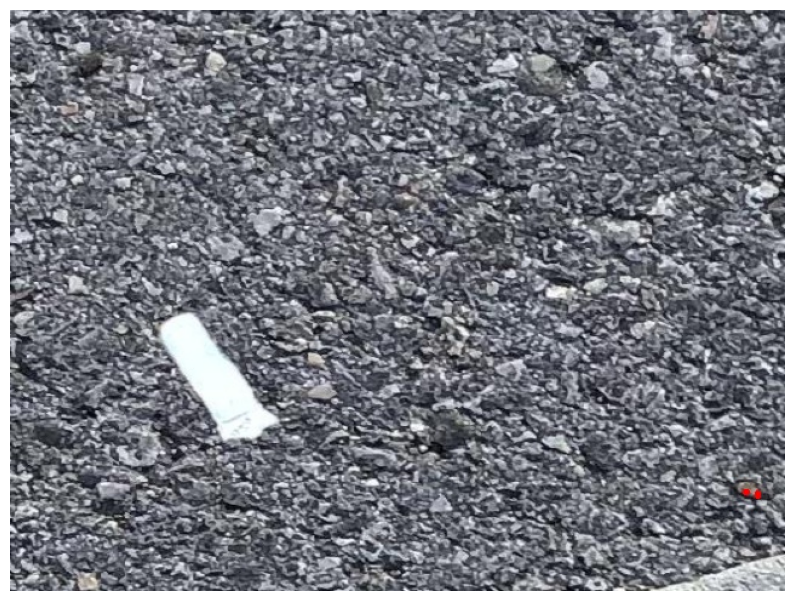

Visualizing 00000045.jpg


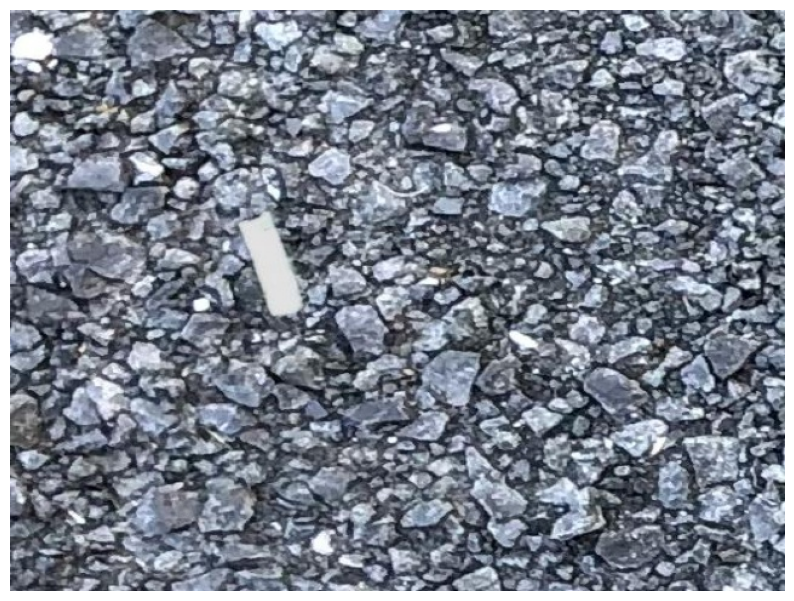

Visualizing 00000046.jpg


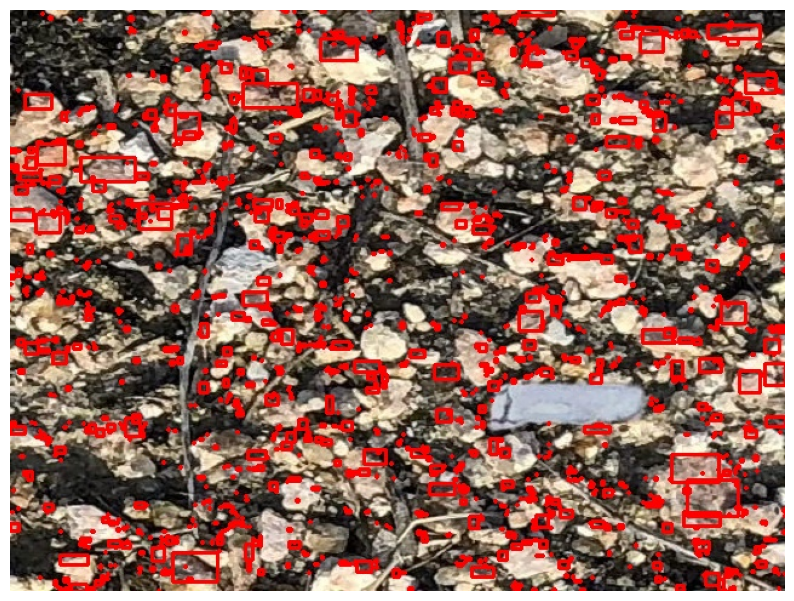

Visualizing 00000048.jpg


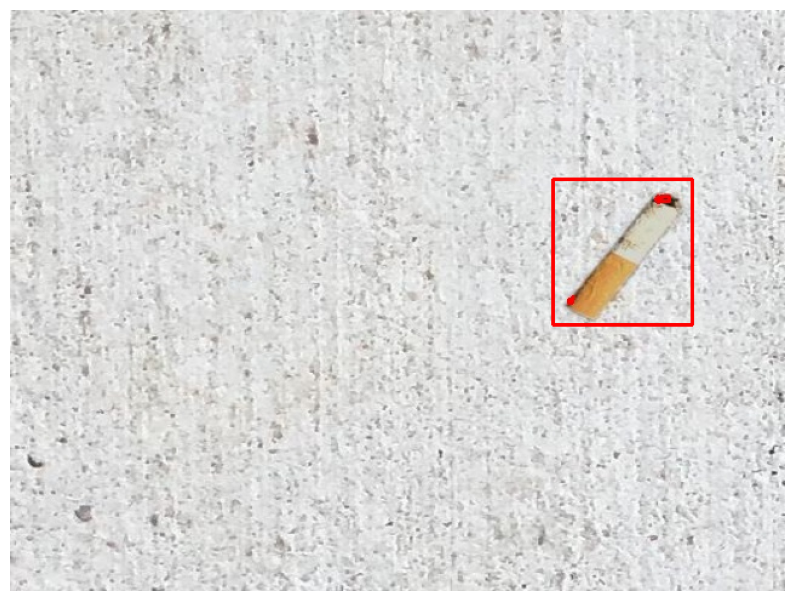

Visualizing 00000047.jpg


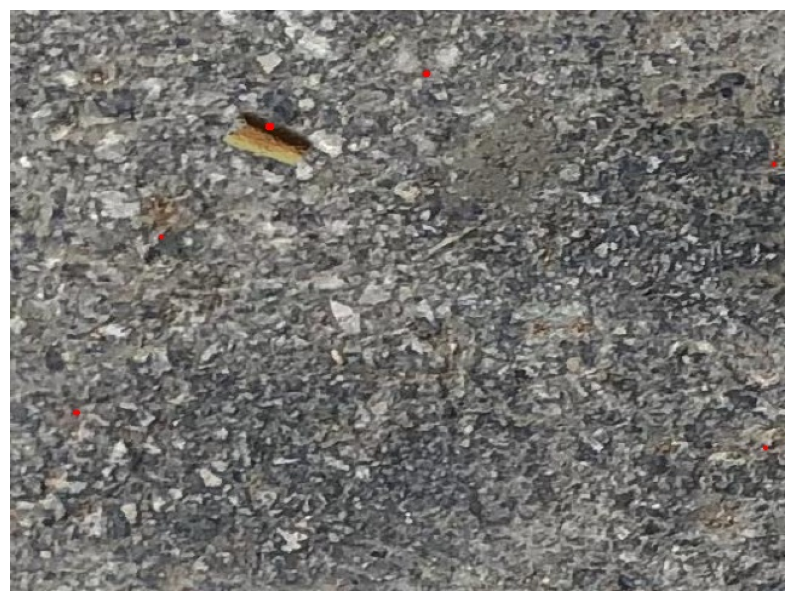

Visualizing 00000050.jpg


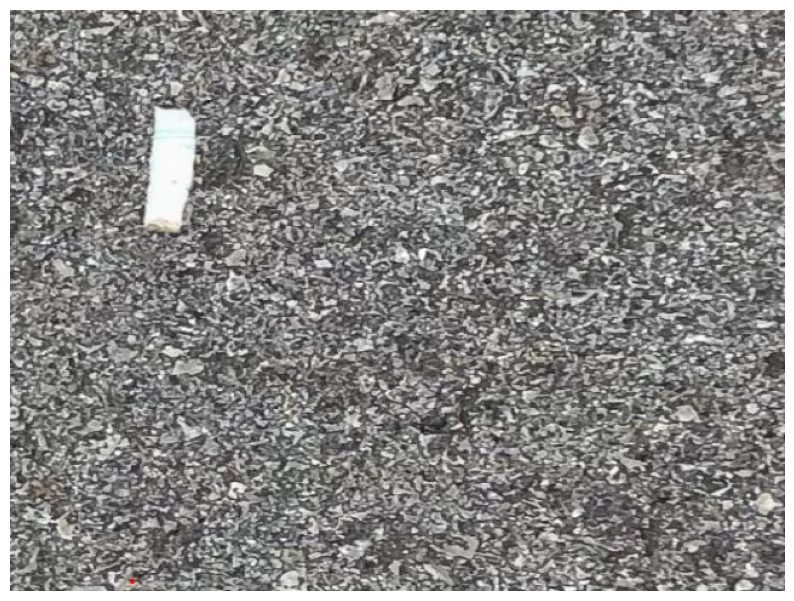

In [ ]:
import matplotlib.pyplot as plt

def visualize_image_with_labels(image_path, label_path):
    # UCITAVANJE SLIKE
    image = cv2.imread(image_path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

    # UCITAVANJE LABELA
    with open(label_path, 'r') as file:
        lines = file.readlines()

    # ISCRTAVANJE LABELA
    for line in lines:
        label = line.strip().split()
        class_id, x1, y1, x2, y2 = map(int, label)
        cv2.rectangle(image, (x1, y1), (x2, y2), (255, 0, 0), 2)

    # PRIKAZ SLIKE
    plt.figure(figsize=(10, 10))
    plt.imshow(image)
    plt.axis('off')
    plt.show()

# VIZUELIZACIJA PRVIH 50
num_images_to_visualize = 50
visualized_count = 0

for filename in os.listdir(unlabeled_images_dir):
    if filename.endswith('.jpg') or filename.endswith('.png'):
        image_path = os.path.join(unlabeled_images_dir, filename)
        label_path = os.path.join(output_labels_dir, filename.replace('.jpg', '.txt').replace('.png', '.txt'))
        if os.path.exists(label_path):
            print(f'Visualizing {filename}')
            visualize_image_with_labels(image_path, label_path)
            visualized_count += 1
            if visualized_count >= num_images_to_visualize:
                break
        else:
            print(f'Label not found for {filename}')
